# 11. 인공지능으로 세상에 없던 새로운 패션 만들기


## 11-14.프로젝트 : CIFAR-10 이미지 생성하기

이미지 데이터의 shape가 (28, 28, 1)에서 (32, 32, 3)으로 변경됩니다. 생성자, 판별자 모델의 입출력 shape 및 모델 구조에 영향이 있습니다.

이미지가 단색의 grayscale에서 RGB 3채널의 컬러이미지로 변경됩니다. 시각화 과정에서 고려할 점이 있습니다.

입력데이터 전체 차원이 3~4배 증가하면서, 학습이 진행되는 양상이 다소 달라집니다.

In [1]:
import tensorflow as tf
import imageio

print(tf.__version__)
print(imageio.__version__)

2.6.0
2.9.0


### STEP 1. 작업환경 구성하기

In [1]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd

### STEP 2. 데이터셋 구성하기

학습에 사용할 train_x의 이미지를 -1, 1로 정규화합니다.

로드한 학습 데이터를 시각화를 통해 확인해 봅시다.

tf.data.Dataset 모듈의 from_tensor_slices() 함수를 사용하여 미니배치 데이터셋을 구성해 봅시다.

In [3]:
def load_data(label=1):
    (train_x, train_y), (test_x, test_y) = tf.keras.datasets.cifar10.load_data()
    if label:
        df = pd.DataFrame(list(zip(train_x, train_y)), columns=['image', 'label']) 
        df = df[df['label']==label]
        train_x = np.array([i for i in list(df['image'])])
        df = pd.DataFrame(list(zip(test_x, test_y)), columns =['image', 'label']) 
        df = df[df['label']==label]
        test_x = np.array([i for i in list(df['image'])])
    
    return train_x, test_x

In [4]:
# cifar10 = tf.keras.datasets.cifar10

train_x, test_x = load_data()

train_x.shape

(5000, 32, 32, 3)

In [5]:
# 전체로 하고싶을때의 경우

# cifar10 = tf.keras.datasets.cifar10

# (train_x, _), (test_x, _) = cifar10.load_data()

# train_x.shape

In [6]:
train_x.max()

255

In [7]:
train_x.min()

0

In [8]:
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다. scaling 

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


In [9]:
train_x.shape

(5000, 32, 32, 3)

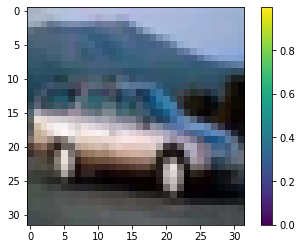

In [10]:
plt.imshow((train_x[0]+1)/2)
plt.colorbar()
plt.show()

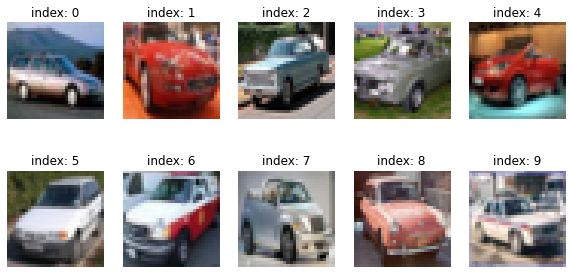

In [11]:
plt.figure(figsize=(10, 5))

for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow((train_x[i]+1)/2)
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

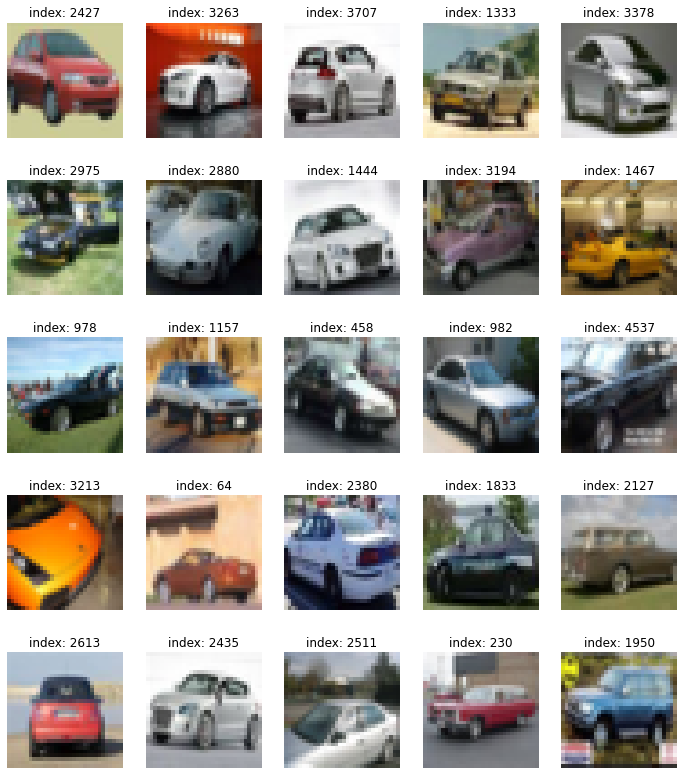

In [12]:
plt.figure(figsize=(12,14))

for i in range(25):
    plt.subplot(5, 5, i+1)
    random_index = np.random.randint(1, 5000)#50000)
    plt.imshow((train_x[random_index]+1)/2)
    plt.title(f'index: {random_index}')
    plt.axis('off')
plt.show()

In [13]:
# BUFFER_SIZE = 50000
BUFFER_SIZE = 5000
BATCH_SIZE = 32#16#256 ###############16

In [14]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## STEP 3. 생성자 모델 구현하기

(32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수를 작성해 봅시다.

noise = tf.random.normal([1, 100])로 생성된 랜덤 노이즈를 입력으로 하여 방금 구현한 생성자로 랜덤 이미지를 생성해 봅시다.

생성된 랜덤 이미지가 생성자 출력 규격에 잘 맞는지 확인해 봅시다.

(32,32,3)
만들기...

In [15]:
# 생성자 모델 만들기

def make_generator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(256, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
     # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(32, kernel_size=(5, 5), strides=(2,2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    
    
    # Fourth: Conv2DTranspose layer######
    model.add(layers.Conv2DTranspose(32, kernel_size=(3,3), strides=(1,1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization(momentum=0.9))
    model.add(layers.LeakyReLU(alpha=0.1))
    
    

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(2,2), strides=(1,1), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

In [16]:
generator = make_generator_model()

generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16384)             0         
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 256)         1638400   
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 256)         0

In [17]:
noise = tf.random.normal([1, 100])

In [18]:
generated_image = generator(noise, training=False)
generated_image.shape

# 첫번째 1은 1개(batch_size =1) 
# 그 뒤로는 (32,32,3) 사이즈이미지 생성

TensorShape([1, 32, 32, 3])

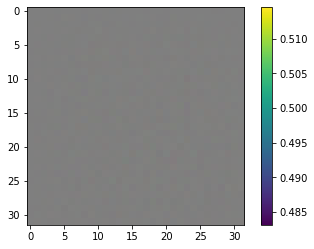

In [19]:
plt.imshow((generated_image[0]+1)/2)
plt.colorbar()
plt.show()

## STEP 4. 판별자 모델 구현하기

(32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 판별자 모델 구현 함수를 작성해 봅시다.

위 STEP 2에서 생성한 랜덤 이미지를 판별자 모델이 판별한 결과값을 확인해 봅시다.

In [20]:
# 판별자 모델
def make_discriminator_model():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(1,1), padding='same', input_shape=[32,32,3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.4))

    
    model.add(layers.Conv2D(64, (5, 5), strides=(1,1), padding='same', input_shape=[32,32,3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.4))
    
    model.add(layers.Conv2D(128, (5, 5), strides=(2,2), padding='same', input_shape=[32,32,3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.4))
    
    
    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(1,1), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.4))

    
     # Second: Conv2D Layer
    model.add(layers.Conv2D(256, (5, 5), strides=(2,2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.4))
    
    
    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

In [21]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 64)        4864      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        102464    
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)      

In [22]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[-0.00016865]], dtype=float32)>

In [23]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True) 

In [24]:
# # 새로운 crossentropy 사용해보기
# cross_entropy = tf.keras.losses.MSE

In [25]:
vector = [[1, 2, 3],
          [4, 5, 6]]

tf.ones_like(vector)

<tf.Tensor: shape=(2, 3), dtype=int32, numpy=
array([[1, 1, 1],
       [1, 1, 1]], dtype=int32)>

## STEP 5. 손실함수와 최적화 함수 구현하기

생성자와 판별자의 손실함수(loss)를 구현해 봅시다.

판별자의 출력값을 가지고 실제/생성(real/fake) 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현해 봅시다.

생성자와 판별자를 최적화하는 optimizer를 정의합니다.

In [26]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [27]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [28]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

옵티마이저 

In [29]:
# 기존
generator_optimizer = tf.keras.optimizers.Adam(1e-4)  # 1e-4
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4) # 1e-4

In [30]:
# # 새로 적용해보는 SGD 옵티마이저
# generator_optimizer = tf.keras.optimizers.Adam(1e-4)  # 1e-4
# discriminator_optimizer = tf.keras.optimizers.SGD(1e-4) # 1e-4

In [31]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

In [32]:
import numpy as np
import tensorflow as tf

def f(x, y):
    print(type(x))
    print(type(y))
    return x ** 2 + y

x = np.array([2, 3])
y = np.array([3, -2])
f(x, y)

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


array([7, 7])

In [33]:
import numpy as np
import tensorflow as tf

@tf.function    # 위와 동일한 함수이지만 @tf.function 데코레이터가 적용되었습니다.
def f(x, y):
    print(type(x))
    print(type(y))
    return x ** 2 + y

x = np.array([2, 3])
y = np.array([3, -2])
f(x, y)

<class 'tensorflow.python.framework.ops.Tensor'>
<class 'tensorflow.python.framework.ops.Tensor'>


<tf.Tensor: shape=(2,), dtype=int64, numpy=array([7, 7])>

## STEP 6. 훈련과정 상세 기능 구현하기

1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현해 봅시다.

16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 시각화하는 generate_and_save_images() 함수를 구현해 봅시다.

훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를 그래프로 시각화하는 draw_train_history() 함수를 구현해 봅시다.

training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 checkpoint 모듈을 설정해 봅시다.

In [34]:
@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True)  #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리턴값

In [35]:
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(8,8))             ##### 여기를 바꾸면 크게 출력되려나
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i]+1)/2.0)
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_car_0250_e500{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()

In [36]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_car_250_e500_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [37]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [38]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

## STEP 7. 학습 과정 진행하기

위 STEP 5에서 구현한 기능들을 활용하여 최소 50 epoch만큼의 모델 학습을 진행해 봅시다.

학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현해 봅시다.

학습 과정을 담은 샘플 이미지, gif 파일, 학습 진행 그래프 이미지를 함께 제출합니다.


In [39]:
save_every = 5
EPOCHS = 500

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [40]:
# checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

# latest = tf.train.latest_checkpoint(checkpoint_dir)
# checkpoint.restore(latest)

# generator = checkpoint.generator
# discriminator = checkpoint.discriminator

# # 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
# noise = tf.random.normal([1, 100])
# generated_image = generator(noise, training=False)

# np_generated = generated_image.numpy()
# np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
# np_generated = np_generated.astype(int)
# plt.imshow(np_generated[0])
# plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

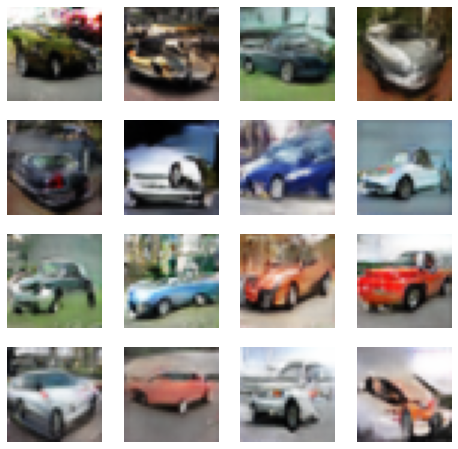

Time for training : 7245 sec


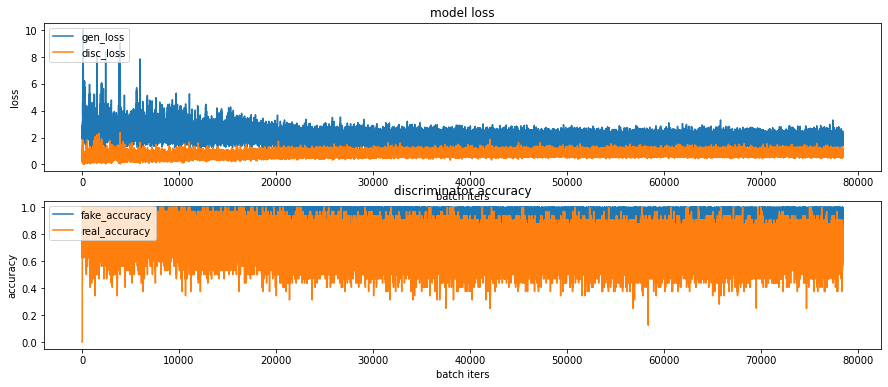

CPU times: user 1h 21min 57s, sys: 10min 46s, total: 1h 32min 44s
Wall time: 2h 49s


In [41]:
%%time 
train(train_dataset, EPOCHS, save_every)

# 학습과정의 loss, accuracy 그래프 이미지 파일이 ~/aiffel/dcgan_newimage/cifar10/training_history 경로에 생성되고 있으니
# 진행 과정을 수시로 확인해 보시길 권합니다.

In [4]:
anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_car_0250_e500.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_car_0250_e500*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

    
!ls -l ~/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_car_0250_e500.gif

-rw-r--r-- 1 root root 9182773 Oct 28 01:03 /aiffel/aiffel/dcgan_newimage/cifar10/cifar10_dcgan_car_0250_e500.gif


<!-- ![cifar10_dcgan_car_0250_e500.gif](attachment:cifar10_dcgan_car_0250_e500.gif) -->

## STEP 8. (optional) GAN 훈련 과정 개선하기

STEP 6을 진행하면서 생성된 샘플 이미지, 학습 과정 그래프 등을 통해 이전 훈련 과정의 문제점을 분석해 봅시다.

모델구조 또는 학습 과정을 개선한 내역과 그 결과(샘플 이미지, 학습 과정 그래프 포함)를 함께 제출합니다.

### [시도1] 50000개의 전체데이터 셋으로 시도해볼 때,

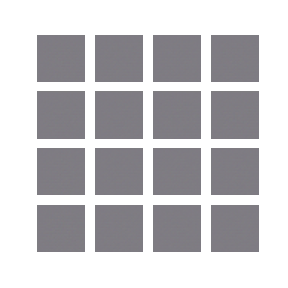

배치가 16이어서 70번을 돌리는데 

CPU times: user 1h 39min 8s, sys: 14min 34s, total: 1h 53min 43s
Wall time: 1h 46min 48s 로 꽤나 오랜시간이 걸렸다

### [시도2] 강아지 데이터셋만 시도했을 경우,

EPOCHS 80 일때, 
batchsize 64


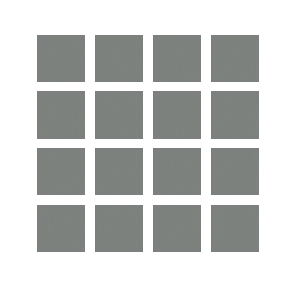

강아지만 선택하니 데이터셋의 양이 5000개로 줄어들어서 50000장의 데이터로 할때 보다 시간이 훨씬 적게 걸렸었다.

그러나 결과로 나온 gif를 보니 성능이 좋지 못한것을 확인했다


### [시도3] 강아지 데이터셋 (파일용량초과로 gif 삭제)

EPOCHS 500 일때,
이번에는 batchsize 16


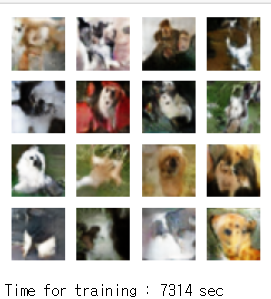


500번은 너무 많이돌려서 
500번 보다 중간중간 나온 결과들이 보기에 더 좋은것 같기도 싶다

<!-- ![cifar10_dcgan_1027_dog_1031_e500.gif](attachment:cifar10_dcgan_1027_dog_1031_e500.gif) -->

<!-- ![image.png](attachment:image.png) -->

<!-- 500번 중 178번째

3번째줄 3번째 이미지가 강아지인게 확실하게 보이는것 같다

![cifar10_dcgan_1027_dog_1031_e178.gif.png](attachment:cifar10_dcgan_1027_dog_1031_e178.gif.png) -->

### [시도4] 강아지 데이터

강아지가 보이는듯 안보이는듯 하다..

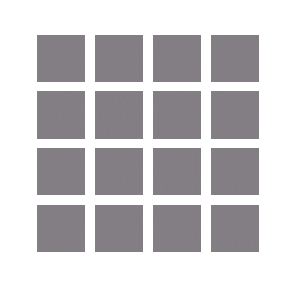



<!-- ![image.png](attachment:image.png) -->

### [시도5] 강아지 데이터 (파일용량초과로 gif 삭제)

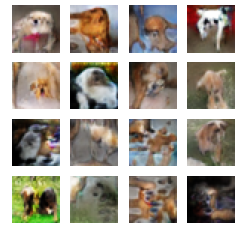

<!-- ![cifar10_dcgan_dog_1450_e300.gif](attachment:cifar10_dcgan_dog_1450_e300.gif) -->

### [시도6-1] 강아지 데이터 

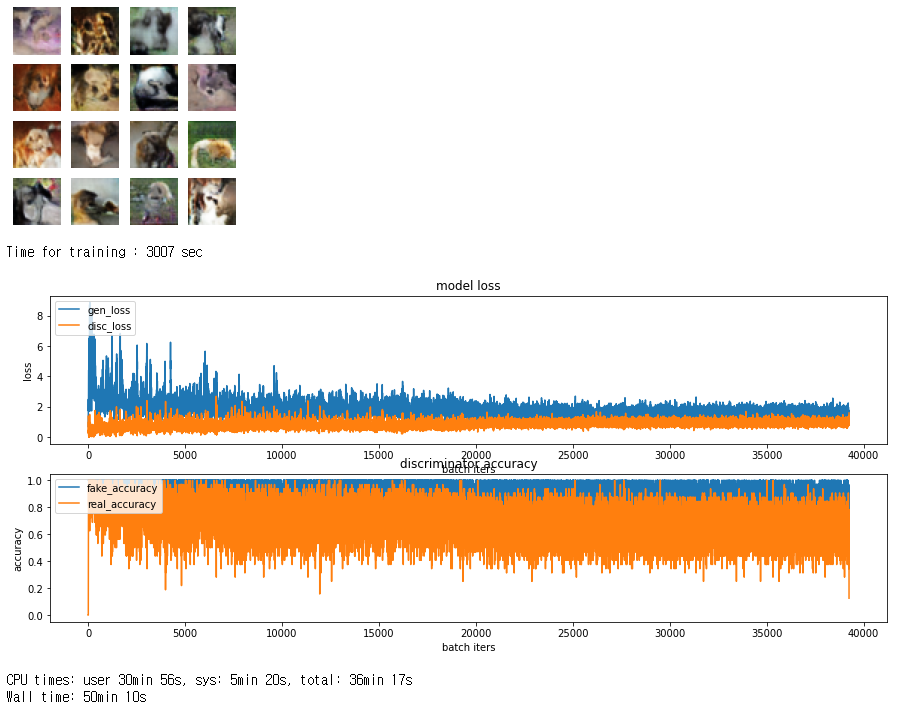


<!-- ![cifar10_dcgan_dog_1630_e300.gif](attachment:cifar10_dcgan_dog_1630_e300.gif) -->

### [시도6-2] 강아지 데이터

위의 결과를가지고 한번더 train을 시도했다
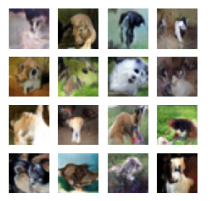

<!-- ![image.png](attachment:image.png) -->

이미지가 선명해지는것 같기도하면서 아닌것 같기도한 애매한 결과물이다

<!-- ![cifar10_dcgan_dog_1630_e300%20%281%29.gif](attachment:cifar10_dcgan_dog_1630_e300%20%281%29.gif) -->

### [시도7] 자동차 데이터

강아지 이미지로는 확실하게 볼 수 없다고 판단하여

자동차로 변경해보고 별다른 변경 없이 그대로 진행해보았다

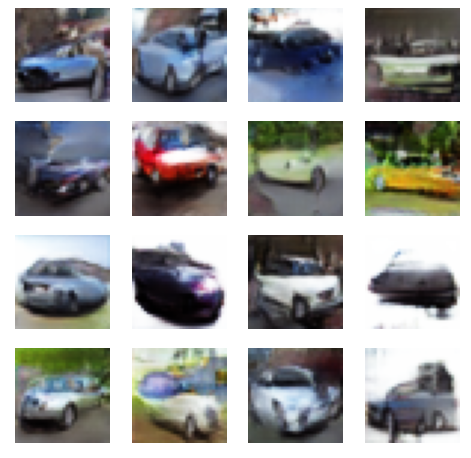

강아지 데이터셋으로 할때 보다 확실한 결과를 볼 수 있었다

<!-- ![image.png](attachment:image.png) -->

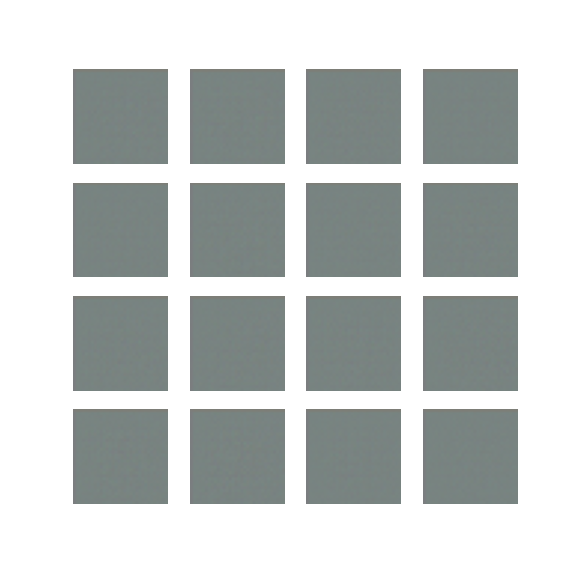

결과 그래프는 만족스럽지 못하지만 결과 이미지는 차인걸 알아볼 수 있었다

생성자
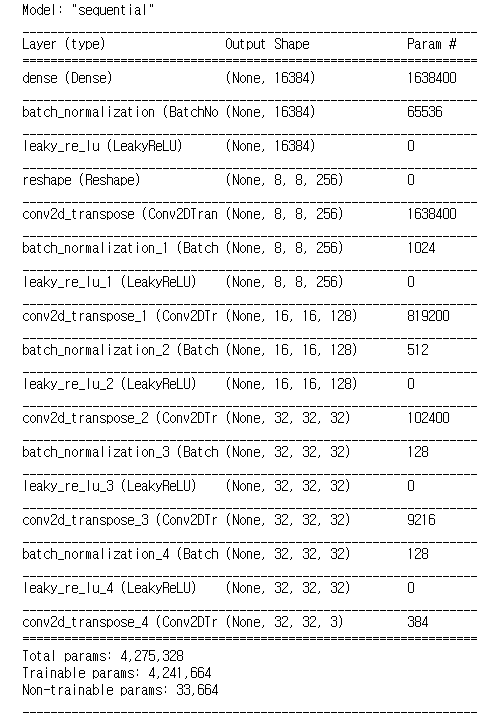

판별자
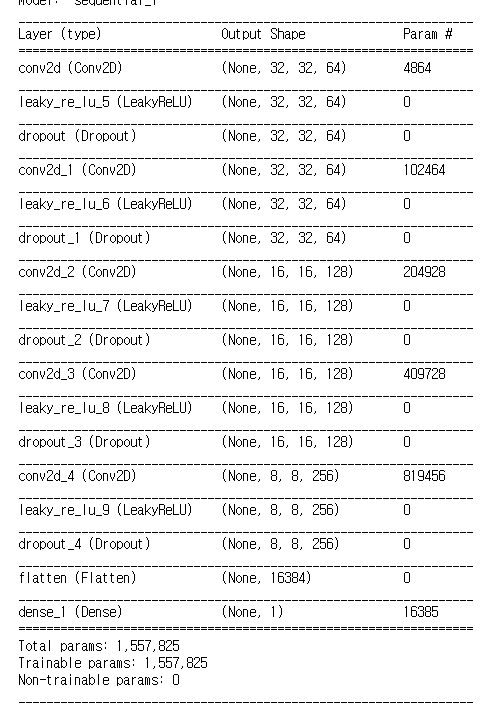

### [번외 시도] 옵티마이저 변경해보기

시도7번의 모델에서 바뀐건 판별자의 옵티마이저를 SGD를 사용해본 결과물이다

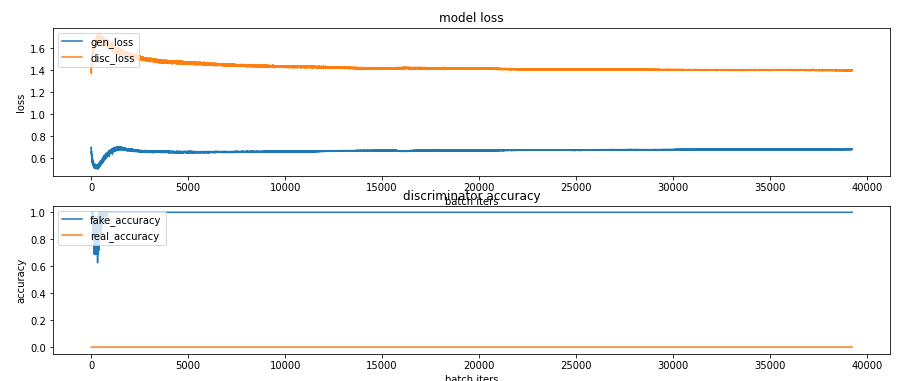

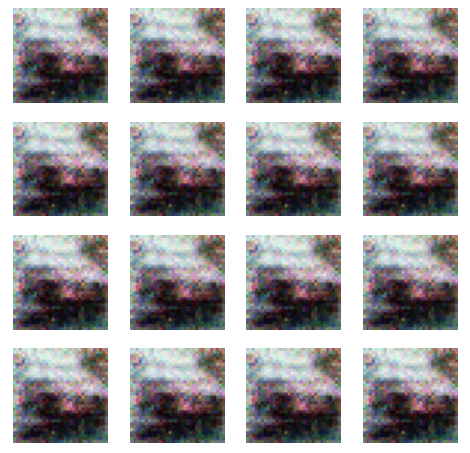

<!-- ![cifar10_dcgan_car_cce_sgd.gif](attachment:cifar10_dcgan_car_cce_sgd.gif) -->

훈련과정을 개선하는데에 참고하는 링크에서 

판별자의 옵티마이저를 adam이나 sgd로 변경해보라고 되어있어서 

adam은 이미 사용했기에 sgd를 적용해보았는데

옵티마이저만 변경했지만 완전히 다른결과가 나온것을 확인했다.

옵티마이저만 바꾼다고 결과가 비슷하거나 같진 않았다. 아마 learning_rate가 너무 낮았던게 아닐까 하는 생각이다.

더 좋은 성능을 보여주거나 그렇지 않은것을 확인했다.

# 회고

- 이번 프로젝트에서 **어려웠던 점,**

어떤 부분을 수정해야 좋은 결과가 나올지 짐작할 수 없어서 막막했다.

그래프에서 fake accuracy가 0.5로 떨어지지 않아 떨어뜨리기 위한 방법을 찾는게 어려웠다.

- 프로젝트를 진행하면서 **알아낸 점** 혹은 **아직 모호한 점**.

(32,32,3)으로 모델을 짜는게 어려울 것 같았지만 어러 값들을 변경해보고 검색을하면서 적용해 볼 수 있었다.

https://www.litcoder.com/?p=2520

tf.keras.layers.Conv2DTranspose()에 어떤 값들이 들어가는지 알 수 있었다.

https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose

어려가지 튜닝을 해보면서 batch_size가 데이터셋이 많을경우 큰숫자여도 결과가 괜찮을 수 있지만, 데이터셋을 5000개로 줄이면서 배치사이즈가 클경우 좋은 결과를 뽑아내지 못 할 수 있다는것을 알았다.

너무 많은 ephocs도 좋지 않은것을 알게되었다.

이번 프로젝트에서 적용한 GAN말고도 PGGAN, LSGAN 등등이 있다는것을 알게되었는데, 1번 시도를 할 때마다 시간이 너무 오래걸려 해당 GAN을 적용해보지 못한게 아쉽다.

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True) 도

BinaryCrossentropy말고 MSE를 사용할 수 있다고했는데, 해당 내용을 적용해보지 못한것과 옵티마이저나 레이어를 쌓는 다양한 시도들을 많이 해보지 못해서 아쉬움이 남는다.


- 루브릭 평가 지표를 맞추기 위해 **시도한 것들**.

오브젝트 종류를 구별 할 수 있도록 모델을 다양하게 구성해보고 이미지를 생성하였다.

gif를 통해 이미지의 품질이 향상되는것을 확인했고,

강아지로 했을 경우, 제대로 확인하지 못했던 것을 자동차로 변경하면서 생성되는 이미지가 확실하게 향상된것을 확인하였다.

모델의 구조를 다양하게 변경해보았고 여러가지 시도를 통해 적용하면서 변화하는 과정을 시각적인 자료로 첨부하였다.

- 만약에 루브릭 평가 관련 지표를 **달성 하지 못했을 때, 이유에 관한 추정**.낌

그래프에서 fake accuracy가 좀처럼 떨어지지 않아 아쉬웠다.



- **자기 다짐**

이번 프로젝트를 하면서 첨부 이외의 시도를 정말 많이 시도했는데, 시간이 오래걸려 더 좋은 방법을 찾지 못한것이 아쉬움에 남는다.

다른 사람들과 각자 결과를 비교해보며 어떤 방법으로 모델을 짜고 시도했는지 비교해보며 과정을 이야기하는것이 즐거웠다.

제출전까지 찾지못한 fake accuracy를 떨어뜨리는 방법을 찾거나, 좋은 품질의 이미지 결과와 그래프가 나온게 궁금하기도하다.
